# Model Deployment
The following report is used to summarise the developmental process in order to produce the final proposed models which are used to predict the labels of recordings from the Google/TensorFlow Speech_Commands_v0.01 dataset.

In [20]:
import os
from os.path import isdir, join
import pandas as pd

# Math
import numpy as np
from scipy.fftpack import fft
from scipy import signal
from scipy.io import wavfile
import librosa

from sklearn.decomposition import PCA

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import IPython.display as ipd
import librosa.display

import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import pandas as pd

%matplotlib inline

In [22]:
train_audio_path = 'data/train/audio/'
processed_audio_path = 'data/processed/'

In [24]:
filename = '/yes/0a7c2a8d_nohash_0.wav'
sample_rate, samples = wavfile.read(str(processed_audio_path) + filename)

## Data Exploration - Anomaly Detection
As well as looking for potential approaches to the problem and identifying issues that exist within the dataset, dimensionality reduction was with a PCA function to plot a graph that demonstrated outlier samples for further analysis as shown below. No label inconsistencies were found but issues with the samples regarding background noise or other anomalous content was discovered

In [30]:
def custom_fft(y, fs):
    T = 1.0 / fs
    N = y.shape[0]
    yf = fft(y)
    xf = np.linspace(0.0, 1.0/(2.0*T), N//2)
    vals = 2.0/N * np.abs(yf[0:N//2])  # FFT is simmetrical, so we take just the first half
    # FFT is also complex, to we take just the real part (abs)
    return xf, vals

In [13]:
to_keep = ['yes','no','left','right','up','down','on','off','stop','go']
[d for d in os.listdir(processed_audio_path) if d in to_keep]
fft_all = []
names = []
for direct in dirs:
    waves = [f for f in os.listdir(join(processed_audio_path, direct)) if f.endswith('.wav')]
    for wav in waves:
        sample_rate, samples = wavfile.read(processed_audio_path + '/'+ direct + '/' + wav)
        if samples.shape[0] != sample_rate:
            samples = np.append(samples, np.zeros((sample_rate - samples.shape[0], )))
        x, val = custom_fft(samples, sample_rate)
        fft_all.append(val)
        names.append(direct + '/' + wav)

fft_all = np.array(fft_all)

# Normalization
fft_all = (fft_all - np.mean(fft_all, axis=0)) / np.std(fft_all, axis=0)

# Dim reduction
pca = PCA(n_components=3)
fft_all = pca.fit_transform(fft_all)

def interactive_3d_plot(data, names):
    scatt = go.Scatter3d(x=data[:, 0], y=data[:, 1], z=data[:, 2], mode='markers',  marker = dict(
          color = 'rgb(17, 157, 255)',
          size = 4,
          opacity = 0.5,
          line = dict(
            color = 'rgb(231, 99, 250)',
            width = 1
          )),text=names)
    data = go.Data([scatt])
    layout = go.Layout(title="Anomaly detection")
    figure = go.Figure(data=data, layout=layout)
    py.iplot(figure)
    
interactive_3d_plot(fft_all, names)

## ETL - Voice Activity Detection
The key implementation during the ETL stage was the Voice Activity Detection function, in which we trimmed samples to only the frames containing voice and padded the rest. This not only standardised the samples, preparing them for processing by the ML models, but allowed for the removal of extra noise in the samples to a degree which resulted in around a 5-10% increase in performance for all models.

In [7]:
dirs = [f for f in os.listdir(train_audio_path) if isdir(join(train_audio_path, f))]
dirs.sort()

num_of_shorter = 0
for direct in dirs:
    waves = [f for f in os.listdir(join(train_audio_path, direct)) if f.endswith('.wav')]
    for wav in waves:
        sample_rate, samples = wavfile.read(train_audio_path+ direct + '/' + wav)
        if samples.shape[0] < sample_rate:
            num_of_shorter += 1
print('Number of recordings shorter than 1 second before ETL: ' + str(num_of_shorter))

Number of recordings shorter than 1 second before ETL: 6476


In [5]:
dirs = [f for f in os.listdir(processed_audio_path) if isdir(join(processed_audio_path, f))]
dirs.sort()

num_of_shorter = 0
for direct in dirs:
    waves = [f for f in os.listdir(join(train_audio_path, direct)) if f.endswith('.wav')]
    for wav in waves:
        sample_rate, samples = wavfile.read(processed_audio_path+ direct + '/' + wav)
        if samples.shape[0] < sample_rate:
            num_of_shorter += 1
print('Number of recordings shorter than 1 second after ETL: ' + str(num_of_shorter))

Number of recordings shorter than 1 second after ETL: 4


## Feature Engineering - Spectrograms and FFTs
The features created from the dataset for use as inputs to our models were Mel-Power Log-scaled Spectrograms, FFT transformations and laterly MFCC Spectrograms.

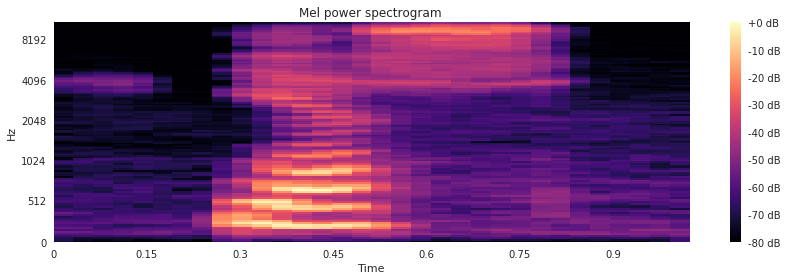

In [27]:

S = librosa.feature.melspectrogram(samples.astype(np.float32), sample_rate, n_mels=128)

# Convert to log scale (dB). We'll use the peak power (max) as reference.
log_S = librosa.power_to_db(S, ref=np.max)

plt.figure(figsize=(12, 4))
librosa.display.specshow(log_S, sr=sample_rate, x_axis='time', y_axis='mel')
plt.title('Mel power spectrogram ')
plt.colorbar(format='%+02.0f dB')
plt.tight_layout()

data = [go.Surface( z=log_S.T)]
layout = go.Layout(
    title='Mel-Scaled Specgtrogram of "yes" in 3d',
    scene = dict(
    yaxis = dict(title='CoEff'),
    xaxis = dict(title='Time'), 
    zaxis = dict(title='Log amplitude'),
    ),
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

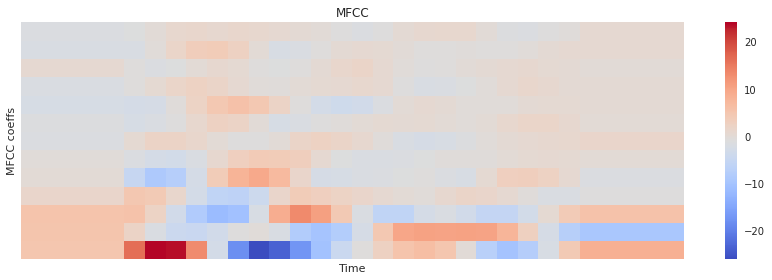

In [28]:
mfcc = librosa.feature.mfcc(S=log_S, n_mfcc=13)

# Let's pad on the first and second deltas while we're at it
delta2_mfcc = librosa.feature.delta(mfcc, order=2)

plt.figure(figsize=(12, 4))
librosa.display.specshow(delta2_mfcc)
plt.ylabel('MFCC coeffs')
plt.xlabel('Time')
plt.title('MFCC')
plt.colorbar()
plt.tight_layout()

data = [go.Surface( z=delta2_mfcc.T)]
layout = go.Layout(
    title='MFCC Specgtrogram of "yes" in 3d',
    scene = dict(
    yaxis = dict(title='CoEff'),
    xaxis = dict(title='Time'), 
    zaxis = dict(title='Log amplitude'),
    ),
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

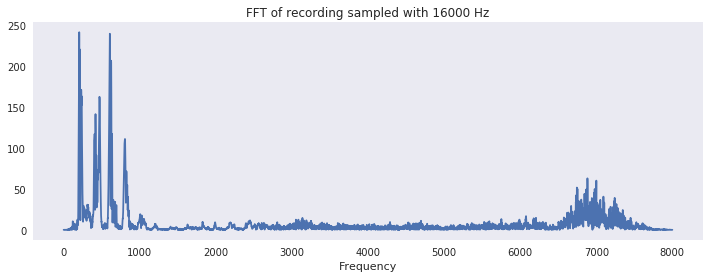

In [31]:
xf, vals = custom_fft(samples, sample_rate)
plt.figure(figsize=(12, 4))
plt.title('FFT of recording sampled with ' + str(sample_rate) + ' Hz')
plt.plot(xf, vals)
plt.xlabel('Frequency')
plt.grid()
plt.show()

## Model Definition - Proposed Models

In [5]:
from sklearn import svm, preprocessing
import pickle
filename = './models/svm_trained.sav'
svm_mod = pickle.load(open(filename,'rb'))
print(svm_mod)

OneVsOneClassifier(estimator=LinearSVC(C=10, class_weight=None, dual=True, fit_intercept=True,
     intercept_scaling=1, loss='squared_hinge', max_iter=10,
     multi_class='ovr', penalty='l2', random_state=0, tol=0.0001,
     verbose=0),
          n_jobs=None)


In [4]:
filename = './models/Neural_Network_trained.sav'
nn_mod = pickle.load(open(filename,'rb'))
print(nn_mod)

MLPClassifier(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
       beta_2=0.999, early_stopping=False, epsilon=1e-08,
       hidden_layer_sizes=(50,), learning_rate='constant',
       learning_rate_init=0.001, max_iter=200, momentum=0.9,
       n_iter_no_change=10, nesterovs_momentum=True, power_t=0.5,
       random_state=None, shuffle=True, solver='adam', tol=0.0001,
       validation_fraction=0.1, verbose=False, warm_start=False)


In [17]:
from keras.models import load_model
sr = load_model('./models/RESNET.h5')
sr.load_weights('./models/resnet8_16_32_Final_0102_last.h5')
print(sr.summary())

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input (InputLayer)              (None, 122, 85, 1)   0                                            
__________________________________________________________________________________________________
conv2d_3 (Conv2D)               (None, 122, 85, 8)   80          input[0][0]                      
__________________________________________________________________________________________________
max_pooling2d_1 (MaxPooling2D)  (None, 61, 43, 8)    0           conv2d_3[0][0]                   
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 61, 43, 8)    32          max_pooling2d_1[0][0]            
__________________________________________________________________________________________________
activation

## Model Evaluation - Results and Confusions

      Unnamed: 0  f1-score  precision  recall  support
0      macro avg     0.251      0.249   0.264     6798
1      micro avg     0.502      0.502   0.502     6798
2            off     0.450      0.379   0.555      256
3          right     0.087      0.104   0.074      256
4        unknown     0.668      0.665   0.672     4221
5            yes     0.243      0.193   0.326      261
6           down     0.082      0.127   0.061      264
7             go     0.185      0.198   0.173      260
8           left     0.093      0.127   0.073      247
9             no     0.168      0.165   0.170      270
10            on     0.330      0.326   0.335      257
11          stop     0.286      0.272   0.301      246
12            up     0.174      0.188   0.162      260
13  weighted avg     0.494      0.491   0.502     6798


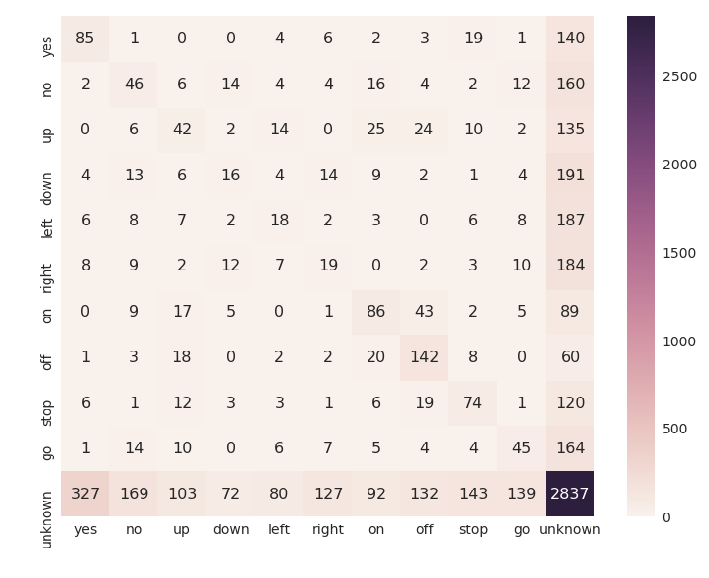

In [48]:

dfsvm = pd.read_csv('graphs/crsvm.csv')
print(dfsvm)
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
img=mpimg.imread('graphs/confmatSVM.png')
plt.figure(figsize = (12,10))
imgplot = plt.imshow(img, aspect='auto')
plt.axis('off')
plt.show()

      Unnamed: 0  f1-score  precision  recall  support
0      macro avg     0.317      0.322   0.316     6798
1      micro avg     0.567      0.567   0.567     6798
2            off     0.471      0.466   0.477      256
3          right     0.194      0.202   0.188      256
4        unknown     0.736      0.725   0.747     4221
5            yes     0.210      0.253   0.180      261
6           down     0.138      0.161   0.121      264
7             go     0.330      0.304   0.362      260
8           left     0.254      0.246   0.263      247
9             no     0.212      0.249   0.185      270
10            on     0.352      0.366   0.339      257
11          stop     0.301      0.266   0.346      246
12            up     0.287      0.302   0.273      260
13  weighted avg     0.561      0.557   0.567     6798


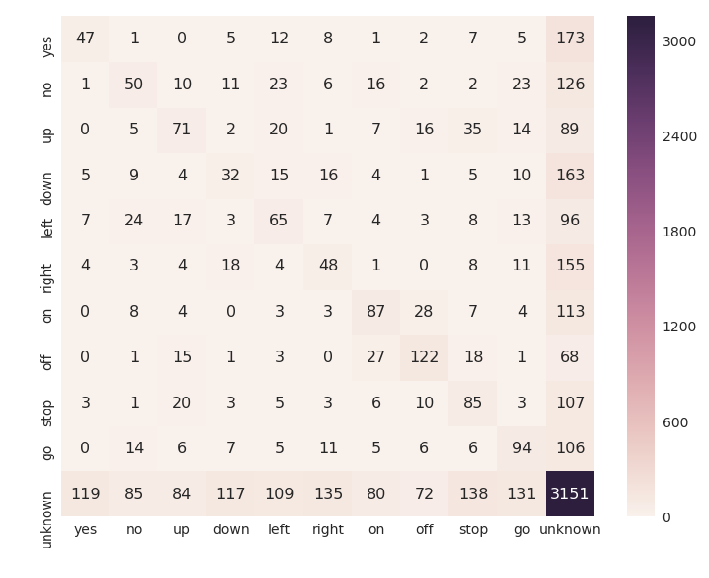

In [49]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
dfmlp = pd.read_csv('graphs/crmlp.csv')
print(dfmlp)
img=mpimg.imread('graphs/confmatMLP.png')
plt.figure(figsize = (12,10))
imgplot = plt.imshow(img, aspect='auto')
plt.axis('off')
plt.show()

      Unnamed: 0  f1-score  precision  recall  support
0      macro avg     0.758      0.751   0.804     6839
1      micro avg     0.820      0.820   0.820     6839
2            off     0.859      0.887   0.832      256
3          right     0.830      0.852   0.809      256
4        unknown     0.888      0.953   0.832     4262
5            yes     0.903      0.914   0.893      261
6           down     0.576      0.442   0.830      264
7             go     0.510      0.369   0.823      260
8           left     0.834      0.917   0.765      247
9             no     0.614      0.778   0.507      270
10            on     0.770      0.765   0.774      257
11          stop     0.830      0.783   0.882      246
12            up     0.719      0.603   0.892      260
13  weighted avg     0.833      0.869   0.820     6839


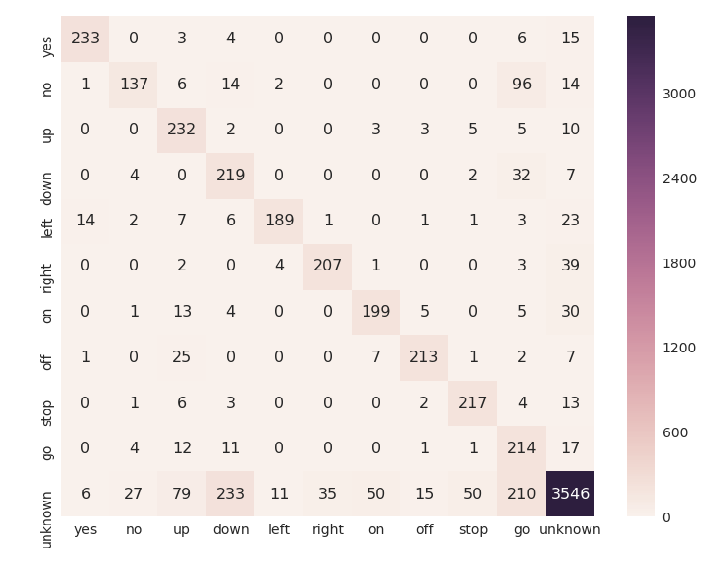

In [47]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

dfresmfcc = pd.read_csv('graphs/crresmfcc.csv')
print(dfresmfcc)
img=mpimg.imread('graphs/confmatRES_MFCC.png')
plt.figure(figsize = (12,10))
imgplot = plt.imshow(img, aspect='auto')
plt.axis('off')
plt.show()

      Unnamed: 0  f1-score  precision  recall  support
0      macro avg     0.890      0.928   0.865     6798
1      micro avg     0.931      0.931   0.931     6798
2            off     0.882      0.976   0.805      256
3          right     0.934      0.902   0.969      256
4        unknown     0.958      0.937   0.979     4221
5            yes     0.916      0.982   0.858      261
6           down     0.912      0.922   0.902      264
7             go     0.860      0.858   0.862      260
8           left     0.966      0.964   0.968      247
9             no     0.815      0.974   0.700      270
10            on     0.823      0.954   0.724      257
11          stop     0.853      0.763   0.967      246
12            up     0.868      0.976   0.781      260
13  weighted avg     0.929      0.934   0.931     6798


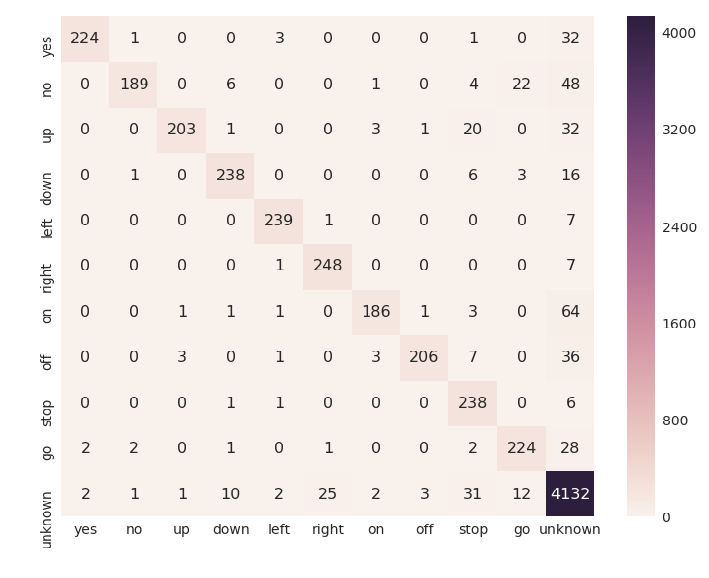

In [46]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

dfres = pd.read_csv('graphs/crres.csv')
print(dfres)
img=mpimg.imread('graphs/confmatRES.png')
plt.figure(figsize = (12,10))
imgplot = plt.imshow(img, aspect='auto')
plt.axis('off')
plt.show()

## Conclusions

Whilst the earlier stage have definitely worked to improve the model to a high level, more hyperparameter tuning of the deep learning models is required to produce a more accurate product. The data is too complex to be classified easily by simpler ML algorithms and does not contain enough information when its dimensions shrink too much (as illustrated in the MFCC case). Besides fine-tuning the current model, transfer learning from a powerful CNN could prove useful here.